# Import

In [1]:
import numpy as np
import healpy as hp
import pandas as pd
import geopandas as gpd

from pyproj import CRS, Transformer
from healpix_geo.nested import healpix_to_lonlat
from healpix_geo.nested import lonlat_to_healpix

import plotly.express as px
import plotly.graph_objects as go

import matplotlib.pyplot as plt

In [2]:
def get_points(NSIDE):
    NPIX = hp.nside2npix(NSIDE)
    points = np.array(
        hp.pix2vec(NSIDE, range(NPIX), nest=True)
    ).T

    df = pd.DataFrame(points, columns=('x', 'y', 'z'))
    df['neighbour'] = 'none'

    return df

def get_patches(NSIDE):
    NPIX = hp.nside2npix(NSIDE)

    pixels = np.arange(NPIX)
    patches = np.array(
        [hp.boundaries(NSIDE, i, nest=True).T for i in pixels]
    ).reshape(-1, 3)

    df = pd.DataFrame(patches, columns=('x', 'y', 'z'))
    df['neighbour'] = 'none'

    return df

# Data

## Borders

In [3]:
kaz = gpd.read_file('data/geoBoundaries-KAZ-ADM0_simplified.geojson')
ukr = gpd.read_file('data/geoBoundaries-UKR-ADM0_simplified.geojson')
rus = gpd.read_file('data/geoBoundaries-RUS-ADM0_simplified.geojson')
blr = gpd.read_file('data/geoBoundaries-BLR-ADM0_simplified.geojson')
borders = pd.concat((kaz, ukr, rus, blr)).reset_index(drop=True)
borders = borders.to_crs(epsg=4326)
borders

,shapeName,shapeISO,shapeID,shapeGroup,shapeType,geometry
0,Kazakhstan,KAZ,12445969B25401373275960,KAZ,ADM0,"MULTIPOLYGON (((50.3741 44.78639, 50.37386 44...."
1,Ukraine,UKR,60985579B58127766181095,UKR,ADM0,"POLYGON ((33.19618 52.37361, 33.19572 52.37895..."
2,Russian Federation,RUS,89588193B69022144921215,RUS,ADM0,"MULTIPOLYGON (((130.82214 42.4629, 130.8202 42..."
3,Belarus,BLR,10690812B6439167788480,BLR,ADM0,"POLYGON ((31.78388 52.10805, 31.78611 52.12416..."


## Airports

In [19]:
airports = pd.read_csv('data/airports.csv')
airports = gpd.GeoDataFrame(
    airports.drop(['GeoPointLat', 'GeoPointLong'], axis=1),
    geometry=gpd.points_from_xy(
        *airports[['GeoPointLong', 'GeoPointLat']].values.T
    ), crs='EPSG:4326'
)
airports[airports.ICAO.isin(['KJFK', 'UAAA'])]

,AirportName,IATA,ICAO,TimeZone,City_Name,City_IATA,UTC_Offset_Hours,UTC_Offset_Seconds,Country_CodeA2,Country_CodeA3,Country_Name,geometry
2169,John F Kennedy Intl,JFK,KJFK,America/New_York,"New York, New York",NYC,-4.0,-14400.0,US,USA,United States of America,POINT (-73.77892 40.63975)
5300,Almaty,ALA,UAAA,Asia/Qyzylorda,Almaty,ALA,5.0,18000.0,KZ,KAZ,Kazakhstan,POINT (77.04051 43.35207)


# Maps

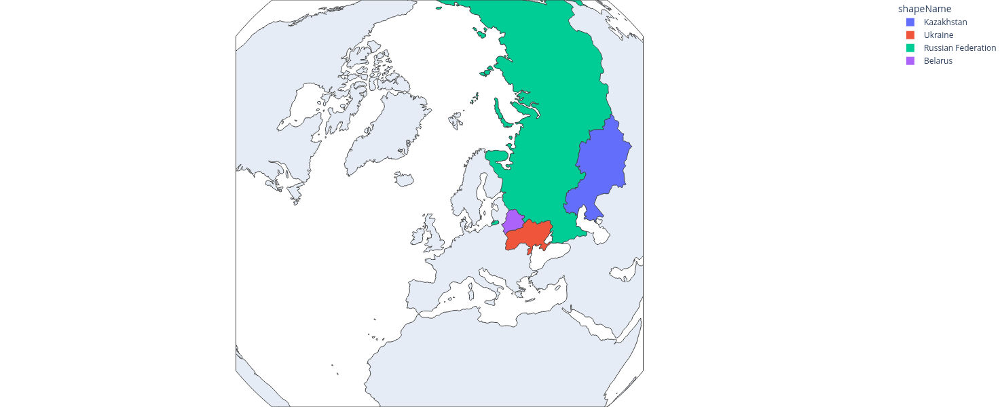

In [11]:
fig = px.choropleth(
    borders,
    geojson=borders.geometry,
    locations=borders.shapeISO,
    locationmode='ISO-3',
    color='shapeName',
)
fig.update_geos(
    fitbounds='locations',
    visible=False,
    projection_type='orthographic',
)
fig.update_layout(
    autosize=False,
    width=900, height=600,
    margin=dict(l=0, r=0, b=0, t=0),
    geo=dict(
        showframe=True,
        showcoastlines=True,
        showland=True,
        #showcountries=True,
    ),
)
fig.show()

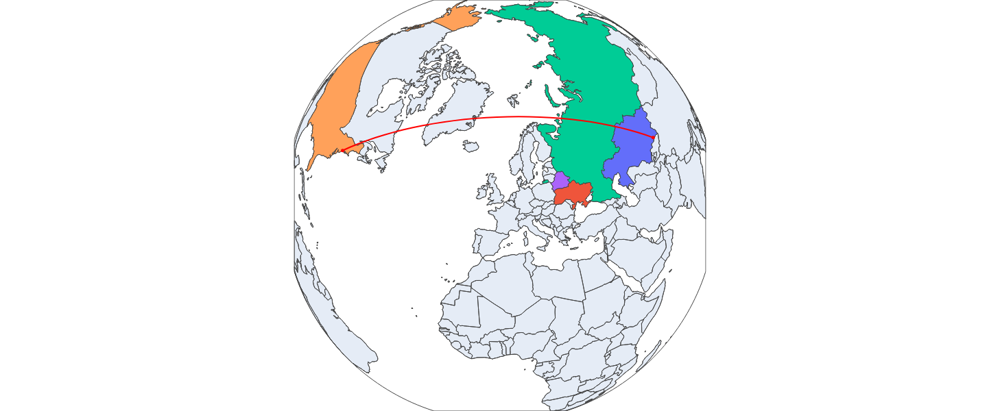

In [35]:
countries = ['KAZ', 'UKR', 'RUS', 'BLR', 'USA']

fig = go.Figure()

trace = go.Choropleth(
    locations=countries,
    z=list(range(len(countries))),
    locationmode='ISO-3',
    colorscale=px.colors.qualitative.Plotly[:len(countries)],
    text=countries,
    showscale=False,
)
fig.add_trace(trace)

route = go.Scattergeo(
    lon=airports[airports.ICAO.isin(['KJFK', 'UAAA'])].geometry.x,
    lat=airports[airports.ICAO.isin(['KJFK', 'UAAA'])].geometry.y,
    mode='lines+markers',
    marker=dict(size=5, color='red'),
)
fig.add_trace(route)

fig.update_geos(
    fitbounds='locations',
    visible=False,
    projection_type='orthographic',
)
fig.update_layout(
    autosize=False,
    width=900, height=600,
    margin=dict(l=0, r=0, b=0, t=0),
    geo=dict(
        showframe=True,
        showcoastlines=True,
        showland=True,
        showcountries=True,
    ),
)
fig.show()

# HEALPix

In [5]:
NSIDE = 32
healpix = get_points(NSIDE)

In [6]:
NPIX = hp.nside2npix(NSIDE)
ipix = np.arange(NPIX)
depth = np.sqrt(NSIDE).astype(int)

In [7]:
lon, lat = healpix_to_lonlat(ipix, depth=depth, ellipsoid='WGS84')
lon = (lon + 180) % 360 - 180

In [8]:
gdf = gpd.GeoDataFrame(
    healpix.drop(['neighbour'], axis=1),
    geometry=gpd.points_from_xy(
        lon, lat
    ), crs='EPSG:4326'
)
gdf

,x,y,z,geometry
0,0.706953,0.706953,0.020833,POINT (45.00000 1.19911)
1,0.688942,0.723618,0.041667,POINT (46.40625 2.39873)
2,0.723618,0.688942,0.041667,POINT (43.59375 2.39873)
3,0.705724,0.705724,0.062500,POINT (45.00000 3.59937)
4,0.670246,0.739503,0.062500,POINT (47.81250 3.59937)
...,...,...,...,...
12283,0.670246,-0.739503,-0.062500,POINT (-47.81250 -3.59937)
12284,0.705724,-0.705724,-0.062500,POINT (-45.00000 -3.59937)
12285,0.723618,-0.688942,-0.041667,POINT (-43.59375 -2.39873)
12286,0.688942,-0.723618,-0.041667,POINT (-46.40625 -2.39873)


In [10]:
gdf['avoid'] = np.array([
    gdf.geometry.within(shape)
    for _, shape
    in borders[borders.shapeISO!='KAZ'].geometry.items()
]).sum(axis=0)

avoid_neighbours = np.unique(
    hp.get_all_neighbours(
        NSIDE, gdf[gdf.avoid==1].index.values, nest=True
    )
)
gdf.loc[avoid_neighbours, 'avoid'] = 1

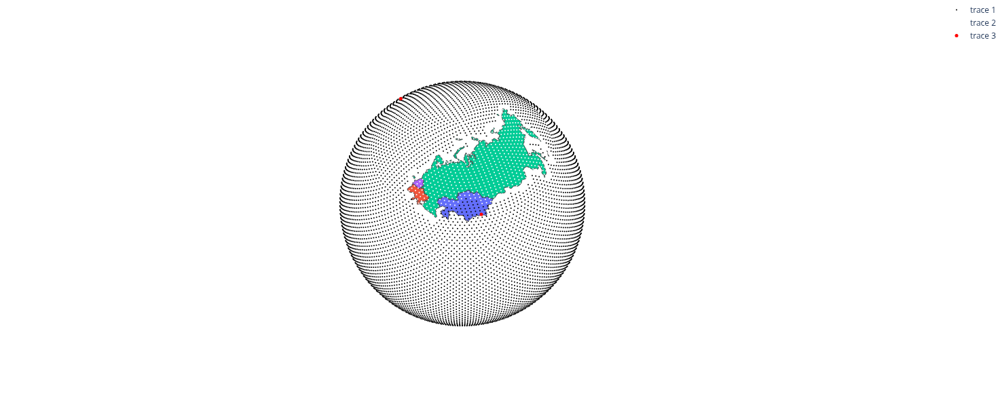

In [11]:
fig = go.Figure()

trace = go.Choropleth(
    geojson=borders.geometry.__geo_interface__,
    locations=borders.shapeISO,
    z=list(range(len(borders))),
    locationmode='ISO-3',
    featureidkey='properties.shapeISO',
    colorscale=px.colors.qualitative.Plotly[:len(borders)],
    text=borders['shapeName'],
    showscale=False,
)
fig.add_trace(trace)

for flag, color in zip(
    [0, 1],
    ['black', 'white']
):
    points = go.Scattergeo(
        lon=gdf[gdf.avoid==flag].geometry.x,
        lat=gdf[gdf.avoid==flag].geometry.y,
        mode='markers',
        marker=dict(size=2, color=color),
    )
    fig.add_trace(points)

route = go.Scattergeo(
    lon=airports[airports.ICAO.isin(['KJFK', 'UAAA'])].geometry.x,
    lat=airports[airports.ICAO.isin(['KJFK', 'UAAA'])].geometry.y,
    mode='markers',
    marker=dict(size=5, color='red'),
)
fig.add_trace(route)

fig.update_geos(
    fitbounds='locations',
    visible=False,
    projection_type='orthographic',
)
fig.update_layout(
    autosize=False,
    width=900, height=600,
    margin=dict(l=0, r=0, b=0, t=0),
)
fig.show()

In [111]:
gdf

,x,y,z,geometry,avoid
0,0.706953,0.706953,0.020833,POINT (45.00000 1.19911),0
1,0.688942,0.723618,0.041667,POINT (46.40625 2.39873),0
2,0.723618,0.688942,0.041667,POINT (43.59375 2.39873),0
3,0.705724,0.705724,0.062500,POINT (45.00000 3.59937),0
4,0.670246,0.739503,0.062500,POINT (47.81250 3.59937),0
...,...,...,...,...,...
12283,0.670246,-0.739503,-0.062500,POINT (-47.81250 -3.59937),0
12284,0.705724,-0.705724,-0.062500,POINT (-45.00000 -3.59937),0
12285,0.723618,-0.688942,-0.041667,POINT (-43.59375 -2.39873),0
12286,0.688942,-0.723618,-0.041667,POINT (-46.40625 -2.39873),0


In [160]:
arr = np.array([3, 5, 2])
arr[[1, 1]] = 0
arr

array([3, 0, 2])

In [ ]:
arr.choose()

In [162]:
dim = len(gdf.index)
connection_mtx = np.diag(np.ones(dim))

neighbours = hp.get_all_neighbours(
    NSIDE, range(dim), nest=True
).T

for idx, neighbour_ids in enumerate(neighbours):
    neighbour_ids = np.where(
        neighbour_ids > 0,
        neighbour_ids,
        idx,
    )
    connection_mtx[idx, neighbour_ids] = 1

for idx in gdf[gdf.avoid==1].index:
    connection_mtx[idx] *= 0
    connection_mtx[idx, idx] = 1

In [78]:
obstacle_mtx = 1 - np.diag(gdf.avoid)

In [79]:
start = lonlat_to_healpix(
    airports[airports.ICAO=='UAAA'].geometry.x,
    airports[airports.ICAO=='UAAA'].geometry.y,
    depth,
    ellipsoid='WGS84',
)[0]
end = lonlat_to_healpix(
    airports[airports.ICAO=='KJFK'].geometry.x,
    airports[airports.ICAO=='KJFK'].geometry.y,
    depth,
    ellipsoid='WGS84',
)[0]

In [81]:
import networkx as nx

In [164]:
G = nx.from_numpy_array(connection_mtx)

In [167]:
route = nx.astar_path(
    G, start, end,
)

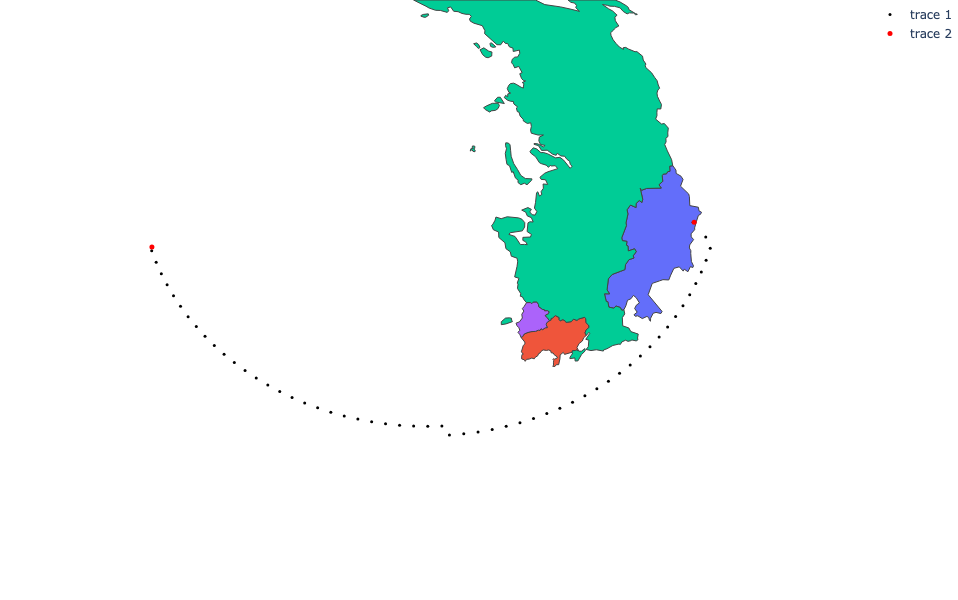

In [168]:
fig = go.Figure()

trace = go.Choropleth(
    geojson=borders.geometry.__geo_interface__,
    locations=borders.shapeISO,
    z=list(range(len(borders))),
    locationmode='ISO-3',
    featureidkey='properties.shapeISO',
    colorscale=px.colors.qualitative.Plotly[:len(borders)],
    text=borders['shapeName'],
    showscale=False,
)
fig.add_trace(trace)

route_trace = go.Scattergeo(
    lon=gdf.iloc[route].geometry.x,
    lat=gdf.iloc[route].geometry.y,
    mode='markers',
    marker=dict(size=3, color='black'),
)
fig.add_trace(route_trace)

start_end = go.Scattergeo(
    lon=airports[airports.ICAO.isin(['KJFK', 'UAAA'])].geometry.x,
    lat=airports[airports.ICAO.isin(['KJFK', 'UAAA'])].geometry.y,
    mode='markers',
    marker=dict(size=5, color='red'),
)
fig.add_trace(start_end)

fig.update_geos(
    fitbounds='locations',
    visible=False,
    projection_type='orthographic',
)
fig.update_layout(
    autosize=False,
    width=900, height=600,
    margin=dict(l=0, r=0, b=0, t=0),
)
fig.show()